In [78]:
# Step 1: Importing necessasery libraries

from datasets import load_dataset
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt
import re, random

import os, glob

In [2]:

#  Step 2: Load subset of the dataset
ds = load_dataset("ashraq/fashion-product-images-small", split="train[:4000]")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/867 [00:00<?, ?B/s]

data/train-00000-of-00002-6cff4c59f91661(…):   0%|          | 0.00/136M [00:00<?, ?B/s]

data/train-00001-of-00002-bb459e5ac5f01e(…):   0%|          | 0.00/135M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/44072 [00:00<?, ? examples/s]

In [3]:
# Basic summary
print("Dataset Summary")
print("-----------------")
ds
print("\nColumns:", ds.column_names)
print("Total samples:", len(ds))

Dataset Summary
-----------------

Columns: ['id', 'gender', 'masterCategory', 'subCategory', 'articleType', 'baseColour', 'season', 'year', 'usage', 'productDisplayName', 'image']
Total samples: 4000


In [4]:
ds.info

DatasetInfo(description='', citation='', homepage='', license='', features={'id': Value('int64'), 'gender': Value('string'), 'masterCategory': Value('string'), 'subCategory': Value('string'), 'articleType': Value('string'), 'baseColour': Value('string'), 'season': Value('string'), 'year': Value('float64'), 'usage': Value('string'), 'productDisplayName': Value('string'), 'image': Image(mode=None, decode=True)}, post_processed=None, supervised_keys=None, builder_name='parquet', dataset_name='fashion-product-images-small', config_name='default', version=0.0.0, splits={'train': SplitInfo(name='train', num_bytes=568896653, num_examples=44072, shard_lengths=[42036, 2036], dataset_name='fashion-product-images-small')}, download_checksums={'hf://datasets/ashraq/fashion-product-images-small@3859c76db2f6f3d3b9a3863345e3ccdbff75879d/data/train-00000-of-00002-6cff4c59f91661c3.parquet': {'num_bytes': 136091680, 'checksum': None}, 'hf://datasets/ashraq/fashion-product-images-small@3859c76db2f6f3d3b9

In [5]:
# Check column data types
print("\nColumn types:")
ds.features


Column types:


{'id': Value('int64'),
 'gender': Value('string'),
 'masterCategory': Value('string'),
 'subCategory': Value('string'),
 'articleType': Value('string'),
 'baseColour': Value('string'),
 'season': Value('string'),
 'year': Value('float64'),
 'usage': Value('string'),
 'productDisplayName': Value('string'),
 'image': Image(mode=None, decode=True)}

In [6]:
# Peek into first few rows
print("\nSample rows:")
ds[:3]


Sample rows:


{'id': [15970, 39386, 59263],
 'gender': ['Men', 'Men', 'Women'],
 'masterCategory': ['Apparel', 'Apparel', 'Accessories'],
 'subCategory': ['Topwear', 'Bottomwear', 'Watches'],
 'articleType': ['Shirts', 'Jeans', 'Watches'],
 'baseColour': ['Navy Blue', 'Blue', 'Silver'],
 'season': ['Fall', 'Summer', 'Winter'],
 'year': [2011.0, 2012.0, 2016.0],
 'usage': ['Casual', 'Casual', 'Casual'],
 'productDisplayName': ['Turtle Check Men Navy Blue Shirt',
  'Peter England Men Party Blue Jeans',
  'Titan Women Silver Watch'],
 'image': [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=60x80>,
  <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=60x80>,
  <PIL.Image.Image image mode=L size=60x80>]}

In [7]:
#  Step 3: Text cleaning helper
def clean_caption(t):
    if t is None:
        return ""
    t = re.sub(r"\s+", " ", str(t).lower().strip())
    return t[:120]  # truncate long captions

In [8]:
#  Step 4: Convert dataset into a DataFrame
records = []
for rec in ds:
    img = rec["image"]
    text = clean_caption(rec["productDisplayName"])
    records.append({
        "text": text,
        "category": rec["masterCategory"],
        "subcategory": rec["subCategory"],
        "gender": rec["gender"],
        "image": img
    })

df = pd.DataFrame(records)
print(f"Loaded {len(df)} valid (image, text) pairs.")
print(df.head())

Loaded 4000 valid (image, text) pairs.
                                            text     category subcategory  \
0               turtle check men navy blue shirt      Apparel     Topwear   
1             peter england men party blue jeans      Apparel  Bottomwear   
2                       titan women silver watch  Accessories     Watches   
3  manchester united men solid black track pants      Apparel  Bottomwear   
4                          puma men grey t-shirt      Apparel     Topwear   

  gender                                              image  
0    Men  <PIL.JpegImagePlugin.JpegImageFile image mode=...  
1    Men  <PIL.JpegImagePlugin.JpegImageFile image mode=...  
2  Women  <PIL.Image.Image image mode=L size=60x80 at 0x...  
3    Men  <PIL.JpegImagePlugin.JpegImageFile image mode=...  
4    Men  <PIL.Image.Image image mode=RGB size=60x80 at ...  


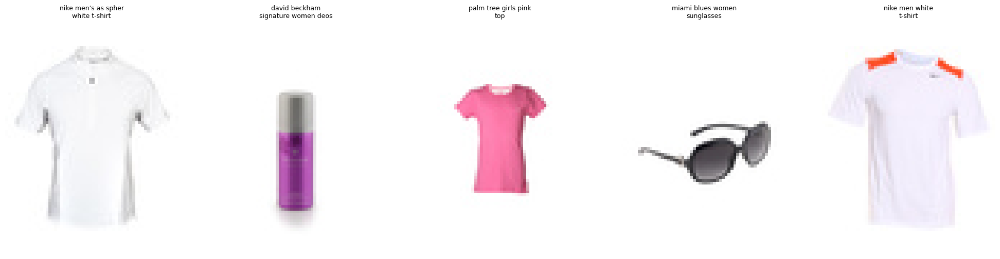

In [9]:
#  Step 5: Visualize random samples
import matplotlib.pyplot as plt
from textwrap import fill

def show_samples(df, n=5):
    samples = df.sample(n).reset_index(drop=True)
    plt.figure(figsize=(4*n, 5))

    for i, (_, row) in enumerate(samples.iterrows()):
        plt.subplot(1, n, i + 1)
        plt.imshow(row["image"])
        plt.axis("off")

        # wrap and shorten title text
        title = fill(str(row["text"])[:80], width=20)
        plt.title(title, fontsize=9, pad=8)

    plt.tight_layout()
    plt.show()

show_samples(df)

In [10]:
#  Step 6: Basic stats
print("\n📊 Category distribution:")
print(df["category"].value_counts().head(10))

print("\n👕 Gender distribution:")
print(df["gender"].value_counts())

# Save the cleaned version
df.to_pickle("fashion_cleaned.pkl")


📊 Category distribution:
category
Apparel          1844
Accessories      1075
Footwear          862
Personal Care     207
Free Items         12
Name: count, dtype: int64

👕 Gender distribution:
gender
Men       1970
Women     1721
Unisex     176
Girls       68
Boys        65
Name: count, dtype: int64


In [11]:
# Install Hugging Face diffusers + CLIP
!pip install -q diffusers transformers torch torchvision pillow

import torch
from transformers import CLIPProcessor, CLIPModel
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt

# Load CLIP model (for embeddings)
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Load a small Stable Diffusion model for quick demo
sd_pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16 if torch.cuda.is_available() else torch.float32
)
sd_pipe = sd_pipe.to("cuda" if torch.cuda.is_available() else "cpu")

print("✅ Environment ready (CLIP + Diffusers initialized)")


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

safety_checker/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


✅ Environment ready (CLIP + Diffusers initialized)


In [12]:
# Taking 5 random product descriptions

import pandas as pd
df = pd.read_pickle("fashion_cleaned.pkl")
print("✅ Reloaded DataFrame:", df.shape)

sample_texts = df["text"].sample(5).tolist()

inputs = clip_processor(
    text=sample_texts,
    return_tensors="pt",
    padding=True
)
with torch.no_grad():
    text_embeds = clip_model.get_text_features(**inputs)

print("✅ Generated CLIP text embeddings with shape:", text_embeds.shape)


✅ Reloaded DataFrame: (4000, 5)
✅ Generated CLIP text embeddings with shape: torch.Size([5, 512])


  0%|          | 0/50 [00:00<?, ?it/s]

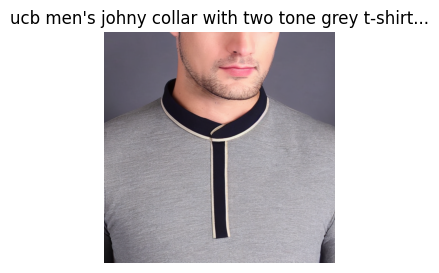

  0%|          | 0/50 [00:00<?, ?it/s]

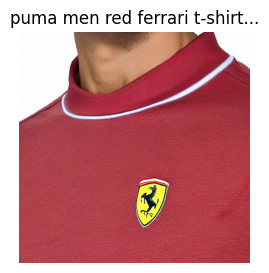

  0%|          | 0/50 [00:00<?, ?it/s]

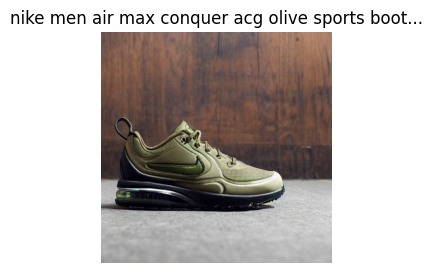

  0%|          | 0/50 [00:00<?, ?it/s]

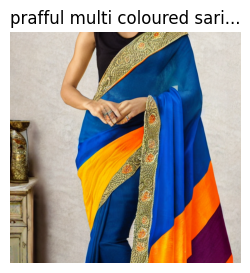

  0%|          | 0/50 [00:00<?, ?it/s]

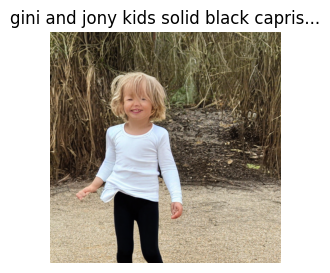

In [13]:
# Generate 5 prompt→image outputs
for i, prompt in enumerate(sample_texts):
    image = sd_pipe(prompt).images[0]
    plt.figure(figsize=(3,3))
    plt.imshow(image)
    plt.axis("off")
    plt.title(prompt[:50]+"...")
    plt.show()

In [14]:
import torch
from diffusers import DDIMScheduler, EulerDiscreteScheduler, PNDMScheduler
import os
import itertools

# --- 1. Setup ---

# Ensure an output directory exists
output_dir = "m2_early_samples"
os.makedirs(output_dir, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"

# --- 2. Define Prompts and Parameters ---

# Using 3 of the sample prompts
prompts = {
    "watch": "titan women silver watch",
    "shirt": "adidas mens fire grey t-shirt",
    "sweatshirt": "proline men green print ed sweatshirt"
}

# Define the parameters to test
param_grid = {
    "guidance_scale": [7.5, 9.0, 12.0],
    "num_inference_steps": [30, 50],
    "scheduler": [
        ("PNDM", PNDMScheduler.from_config(sd_pipe.scheduler.config)),
        ("DDIM", DDIMScheduler.from_config(sd_pipe.scheduler.config)),
        ("Euler", EulerDiscreteScheduler.from_config(sd_pipe.scheduler.config))
    ]
}

# --- 3. Run Experiment Loop ---

print("Starting Milestone 2 inference tuning...")
print(f"Saving images to: {output_dir}/")

log_entries = []

# Iterate over each prompt
for prompt_key, prompt_text in prompts.items():
    print(f"\n--- Processing prompt: '{prompt_text}' ---")

    # Iterate over each combination of parameters
    for guidance, steps, (scheduler_name, scheduler_obj) in itertools.product(
        param_grid["guidance_scale"],
        param_grid["num_inference_steps"],
        param_grid["scheduler"]
    ):

        # Set the pipeline's scheduler
        sd_pipe.scheduler = scheduler_obj

        # Generate a unique filename
        filename = f"{prompt_key}_g{guidance}_s{steps}_{scheduler_name}.png"
        output_path = os.path.join(output_dir, filename)

        log_msg = f"Generating: {filename}"
        print(log_msg)

        # Generate the image
        with torch.no_grad():
            image = sd_pipe(
                prompt_text,
                guidance_scale=guidance,
                num_inference_steps=steps
            ).images[0]

        # Save the image
        image.save(output_path)

        # Add to log
        log_entries.append(log_msg)

print("\n--- Experiment complete ---")
print(f"Generated {len(log_entries)} sample images in '{output_dir}'.")

Starting Milestone 2 inference tuning...
Saving images to: m2_early_samples/

--- Processing prompt: 'titan women silver watch' ---
Generating: watch_g7.5_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g7.5_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g7.5_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g7.5_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g7.5_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g7.5_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g9.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g9.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g9.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g9.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g9.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g9.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g12.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g12.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g12.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: watch_g12.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g12.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: watch_g12.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]


--- Processing prompt: 'adidas mens fire grey t-shirt' ---
Generating: shirt_g7.5_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g7.5_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g7.5_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g7.5_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g7.5_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g7.5_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g9.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g9.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g9.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g9.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g9.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g9.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g12.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g12.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g12.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: shirt_g12.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g12.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: shirt_g12.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]


--- Processing prompt: 'proline men green print ed sweatshirt' ---
Generating: sweatshirt_g7.5_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g7.5_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g7.5_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g7.5_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g7.5_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g7.5_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g9.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s30_PNDM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s30_DDIM.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s30_Euler.png


  0%|          | 0/30 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s50_PNDM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s50_DDIM.png


  0%|          | 0/50 [00:00<?, ?it/s]

Generating: sweatshirt_g12.0_s50_Euler.png


  0%|          | 0/50 [00:00<?, ?it/s]


--- Experiment complete ---
Generated 54 sample images in 'm2_early_samples'.


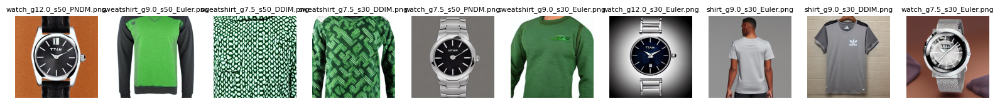

In [15]:
import matplotlib.pyplot as plt
from PIL import Image
import glob

# Get list of generated images
image_paths = glob.glob("m2_early_samples/*.png")[:10] # Show first 5

plt.figure(figsize=(20, 5))
for i, img_path in enumerate(image_paths):
    img = Image.open(img_path)
    plt.subplot(1, 10, i+1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(os.path.basename(img_path), fontsize=8)
plt.show()

In [16]:
!pip install pytorch-fid scipy
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-sas8kca5
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-sas8kca5
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=aedfde55145a7823dca476dea1a91732eda5eb430dcf4fd122da3584e10324f0
  Stored in directory: /tmp/pip-ephem-wheel-cache-1611zpdd/wheels/35/3e/df/3d24cbfb3b6a06f17a2bfd7d1138900d4365d9028aa8f6e92f
Successfully built clip


# Preparing Real Images for FID Calculation


In [17]:
import os
import shutil
from PIL import Image

# Create directory for real images
real_images_dir = "real_fashion_images"
os.makedirs(real_images_dir, exist_ok=True)

# Save subset of real images (500-1000 images)
df = pd.read_pickle("fashion_cleaned.pkl")
sample_size = 500

for idx, row in df.sample(sample_size).iterrows():
    img = row["image"]
    # Resize to match generated image size (512x512 for Stable Diffusion)
    img_resized = img.resize((512, 512))
    img_resized.save(f"{real_images_dir}/real_{idx}.png")

print(f"Saved {sample_size} real images for FID calculation")

Saved 500 real images for FID calculation


# Calculating Fréchet Inception Distance (FID)


In [18]:
# Compute FID Score
from pytorch_fid import fid_score

# Calculate FID between generated and real images
fid_value = fid_score.calculate_fid_given_paths(
    [real_images_dir, "m2_early_samples"],
    batch_size=50,
    device='cuda' if torch.cuda.is_available() else 'cpu',
    dims=2048
)

print(f"FID Score: {fid_value:.2f}")

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth


100%|██████████| 91.2M/91.2M [00:00<00:00, 244MB/s]
100%|██████████| 2/2 [00:01<00:00,  1.63it/s]


FID Score: 245.41


In [19]:
# FID for Different Parameter Settings
# Organize images by parameters
import glob
from collections import defaultdict

fid_results = {}

# Group by guidance scale
for guidance in [7.5, 9.0, 12.0]:
    temp_dir = f"temp_guidance_{guidance}"
    os.makedirs(temp_dir, exist_ok=True)

    # Copy images with this guidance scale
    pattern = f"m2_early_samples/*_g{guidance}_*.png"
    for img_path in glob.glob(pattern):
        shutil.copy(img_path, temp_dir)

    # Calculate FID
    if len(os.listdir(temp_dir)) > 0:
        fid = fid_score.calculate_fid_given_paths(
            [real_images_dir, temp_dir],
            batch_size=50,
            device='cuda' if torch.cuda.is_available() else 'cpu',
            dims=2048
        )
        fid_results[f"guidance_{guidance}"] = fid
    shutil.rmtree(temp_dir)

print("FID by Guidance Scale:")
for key, value in fid_results.items():
    print(f"{key}: {value:.2f}")

100%|██████████| 10/10 [00:05<00:00,  1.80it/s]


100%|██████████| 10/10 [00:05<00:00,  1.82it/s]


100%|██████████| 10/10 [00:05<00:00,  1.82it/s]


100%|██████████| 1/1 [00:00<00:00,  2.01it/s]


FID by Guidance Scale:
guidance_7.5: 281.92
guidance_9.0: 270.93
guidance_12.0: 267.58


# Calculating Inception Score (IS)


In [20]:
# Implement IS Calculation
import torch
import torch.nn as nn
from torchvision.models import inception_v3
from scipy.stats import entropy
import numpy as np

def calculate_inception_score(images, batch_size=32, splits=10):
    """
    Calculate Inception Score for generated images
    """
    # Load Inception v3 model
    inception_model = inception_v3(pretrained=True, transform_input=False)
    inception_model.eval()
    inception_model = inception_model.to('cuda' if torch.cuda.is_available() else 'cpu')

    # Prepare images
    from torchvision import transforms
    transform = transforms.Compose([
        transforms.Resize((299, 299)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                           std=[0.229, 0.224, 0.225])
    ])

    preds = []
    for img_path in images:
        img = Image.open(img_path).convert('RGB')
        img_tensor = transform(img).unsqueeze(0)
        img_tensor = img_tensor.to('cuda' if torch.cuda.is_available() else 'cpu')

        with torch.no_grad():
            pred = inception_model(img_tensor)
            pred = nn.functional.softmax(pred, dim=1)
            preds.append(pred.cpu().numpy())

    preds = np.concatenate(preds, axis=0)

    # Calculate IS
    split_scores = []
    for k in range(splits):
        part = preds[k * (len(preds) // splits): (k + 1) * (len(preds) // splits), :]
        py = np.mean(part, axis=0)
        scores = []
        for i in range(part.shape[0]):
            pyx = part[i, :]
            scores.append(entropy(pyx, py))
        split_scores.append(np.exp(np.mean(scores)))

    return np.mean(split_scores), np.std(split_scores)

# Calculate IS for your generated images
generated_images = glob.glob("m2_early_samples/*.png")
is_mean, is_std = calculate_inception_score(generated_images)

print(f"Inception Score: {is_mean:.2f} ± {is_std:.2f}")

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth


100%|██████████| 104M/104M [00:00<00:00, 188MB/s] 


Inception Score: 2.43 ± 0.26


# Qualitative Evaluation - Semantic Alignment


In [21]:
# CLIP Similarity Scores
import clip
from PIL import Image

# Load CLIP model
device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, preprocess = clip.load("ViT-B/32", device=device)

def calculate_clip_score(image_path, text_prompt):
    """Calculate CLIP similarity between image and text"""
    image = preprocess(Image.open(image_path)).unsqueeze(0).to(device)
    text = clip.tokenize([text_prompt]).to(device)

    with torch.no_grad():
        image_features = clip_model.encode_image(image)
        text_features = clip_model.encode_text(text)

        # Normalize features
        image_features = image_features / image_features.norm(dim=-1, keepdim=True)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

        # Calculate cosine similarity
        similarity = (image_features @ text_features.T).item()

    return similarity

# Evaluate alignment for your prompts
prompts = {
    "watch": "titan women silver watch",
    "shirt": "adidas mens fire grey t-shirt",
    "sweatshirt": "proline men green printed sweatshirt"
}

alignment_scores = {}
for prompt_key, prompt_text in prompts.items():
    scores = []
    pattern = f"m2_early_samples/{prompt_key}_*.png"

    for img_path in glob.glob(pattern):
        score = calculate_clip_score(img_path, prompt_text)
        scores.append(score)

    alignment_scores[prompt_key] = {
        'mean': np.mean(scores),
        'std': np.std(scores),
        'min': np.min(scores),
        'max': np.max(scores)
    }

# Print results
for prompt, stats in alignment_scores.items():
    print(f"\n{prompt}:")
    print(f"  Mean CLIP Score: {stats['mean']:.3f} ± {stats['std']:.3f}")
    print(f"  Range: [{stats['min']:.3f}, {stats['max']:.3f}]")

100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 219MiB/s]



watch:
  Mean CLIP Score: 0.319 ± 0.032
  Range: [0.268, 0.374]

shirt:
  Mean CLIP Score: 0.341 ± 0.033
  Range: [0.276, 0.381]

sweatshirt:
  Mean CLIP Score: 0.350 ± 0.024
  Range: [0.303, 0.407]


# Parameter Sensitivity Analysis


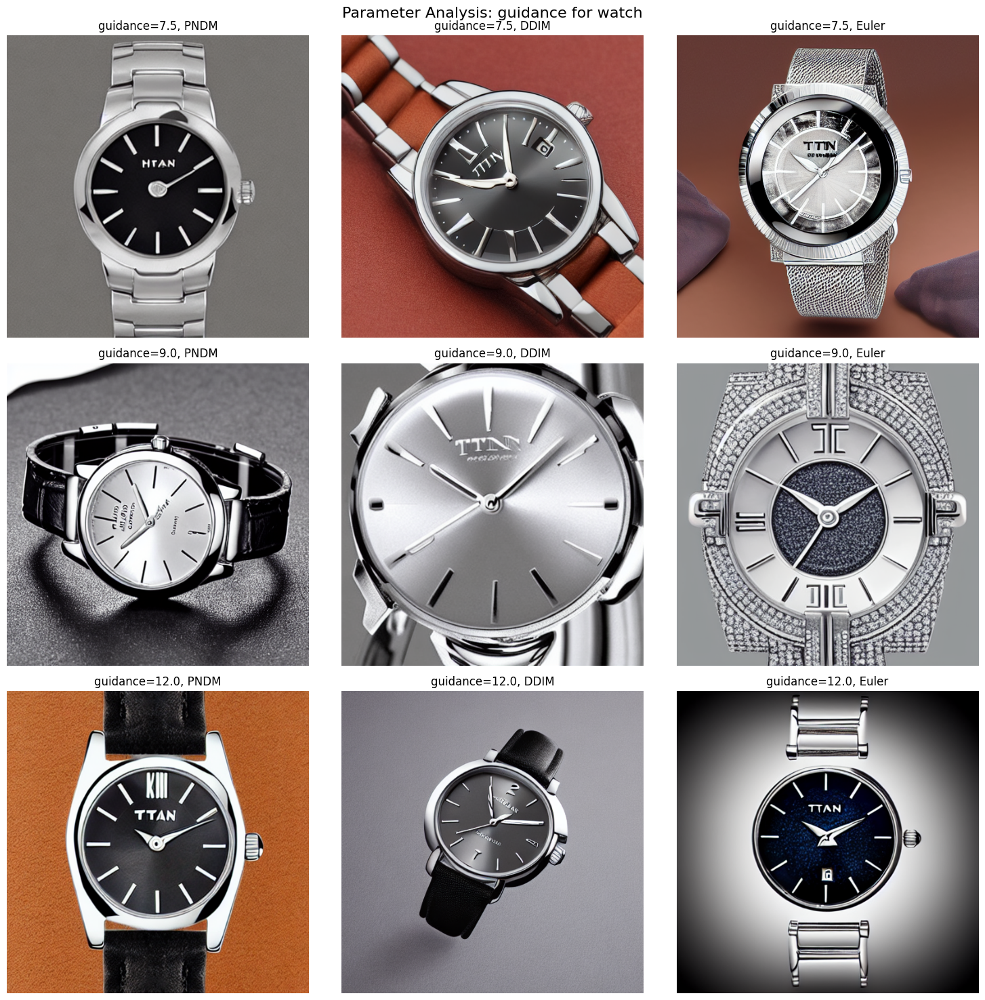

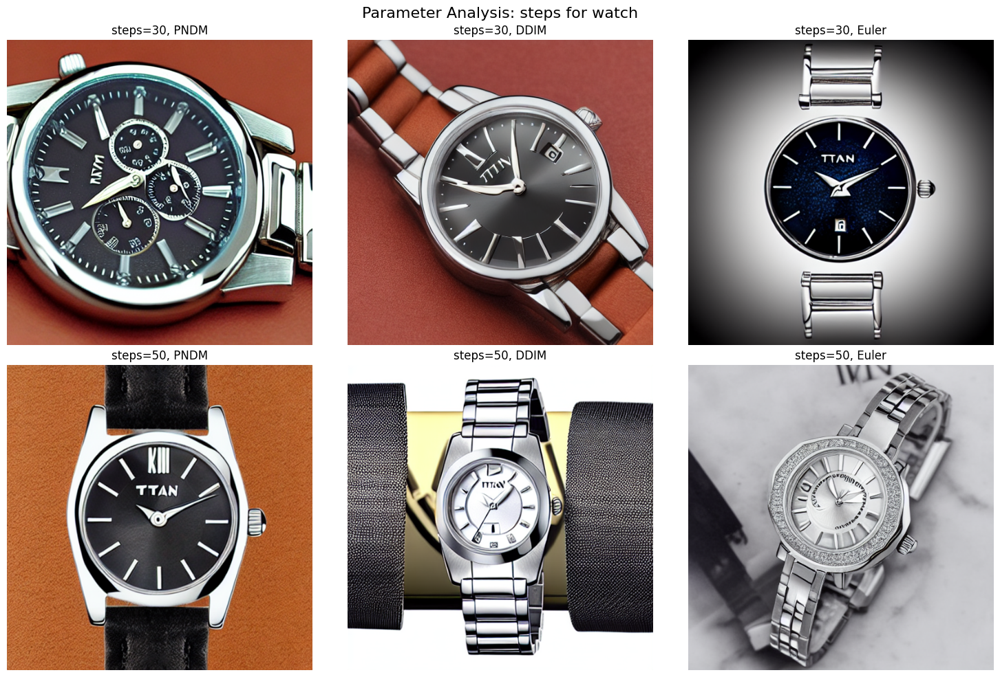

In [22]:
# Create Comparison Grids
import matplotlib.pyplot as plt
from PIL import Image

def create_parameter_comparison_grid(prompt_key, param_name, param_values):
    """
    Create a grid comparing different parameter values
    """
    fig, axes = plt.subplots(len(param_values), 3, figsize=(15, 5*len(param_values)))
    fig.suptitle(f'Parameter Analysis: {param_name} for {prompt_key}', fontsize=16)

    schedulers = ['PNDM', 'DDIM', 'Euler']

    for i, param_val in enumerate(param_values):
        for j, scheduler in enumerate(schedulers):
            # Find matching image
            if param_name == "guidance":
                pattern = f"m2_early_samples/{prompt_key}_g{param_val}_*_{scheduler}.png"
            elif param_name == "steps":
                pattern = f"m2_early_samples/{prompt_key}_*_s{param_val}_{scheduler}.png"

            matches = glob.glob(pattern)
            if matches:
                img = Image.open(matches[0])
                axes[i, j].imshow(img)
                axes[i, j].axis('off')
                axes[i, j].set_title(f'{param_name}={param_val}, {scheduler}')

    plt.tight_layout()
    plt.savefig(f'analysis_{prompt_key}_{param_name}.png', dpi=150, bbox_inches='tight')
    plt.show()

# Create grids for each parameter
create_parameter_comparison_grid("watch", "guidance", [7.5, 9.0, 12.0])
create_parameter_comparison_grid("watch", "steps", [30, 50])

In [23]:
# Quantitative Parameter Analysis
# Analyze CLIP scores by parameter
results_df = []

for img_path in glob.glob("m2_early_samples/*.png"):
    filename = os.path.basename(img_path)

    # Parse filename: prompt_gGUIDANCE_sSTEPS_SCHEDULER.png
    parts = filename.replace('.png', '').split('_')

    prompt_key = parts[0]
    guidance = float(parts[1].replace('g', ''))
    steps = int(parts[2].replace('s', ''))
    scheduler = parts[3]

    # Calculate CLIP score
    prompt_text = prompts[prompt_key]
    clip_score = calculate_clip_score(img_path, prompt_text)

    results_df.append({
        'prompt': prompt_key,
        'guidance': guidance,
        'steps': steps,
        'scheduler': scheduler,
        'clip_score': clip_score,
        'filename': filename
    })

results_df = pd.DataFrame(results_df)

# Analyze trends
print("\n=== CLIP Score by Guidance Scale ===")
print(results_df.groupby('guidance')['clip_score'].agg(['mean', 'std']))

print("\n=== CLIP Score by Inference Steps ===")
print(results_df.groupby('steps')['clip_score'].agg(['mean', 'std']))

print("\n=== CLIP Score by Scheduler ===")
print(results_df.groupby('scheduler')['clip_score'].agg(['mean', 'std']))


=== CLIP Score by Guidance Scale ===
              mean       std
guidance                    
7.5       0.337335  0.033562
9.0       0.329997  0.035191
12.0      0.342122  0.030865

=== CLIP Score by Inference Steps ===
           mean       std
steps                    
30     0.332022  0.035369
50     0.340947  0.030470

=== CLIP Score by Scheduler ===
               mean       std
scheduler                    
DDIM       0.335720  0.031621
Euler      0.348212  0.027211
PNDM       0.325521  0.037182


# Visualization Plots


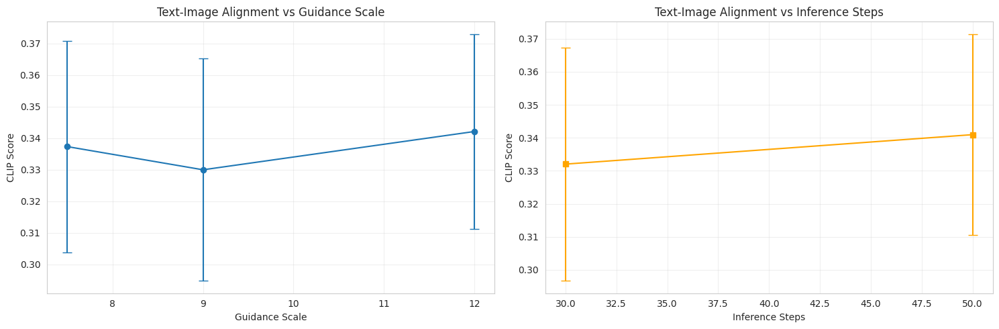

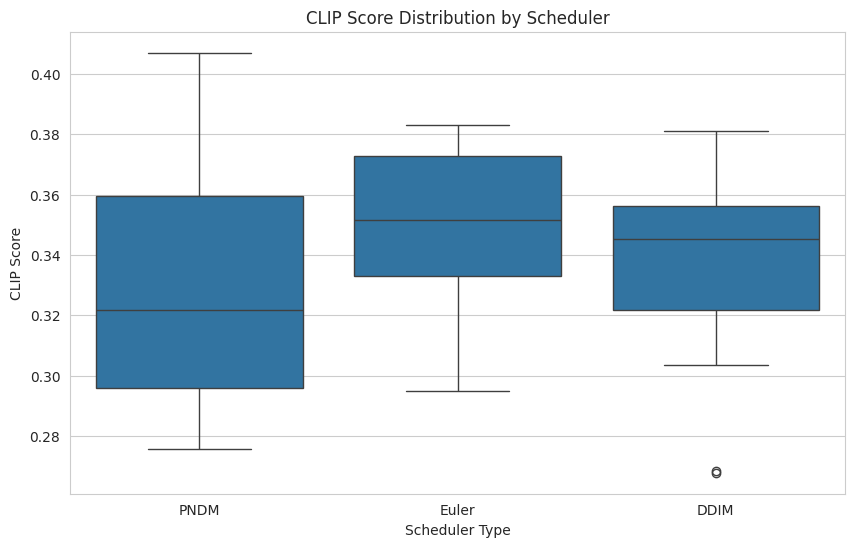

In [24]:
# Parameter Impact Plots
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
sns.set_style("whitegrid")

# Plot 1: Guidance Scale Impact
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# CLIP Score vs Guidance
guidance_stats = results_df.groupby('guidance')['clip_score'].agg(['mean', 'std'])
axes[0].errorbar(guidance_stats.index, guidance_stats['mean'],
                 yerr=guidance_stats['std'], marker='o', capsize=5)
axes[0].set_xlabel('Guidance Scale')
axes[0].set_ylabel('CLIP Score')
axes[0].set_title('Text-Image Alignment vs Guidance Scale')
axes[0].grid(True, alpha=0.3)

# CLIP Score vs Steps
steps_stats = results_df.groupby('steps')['clip_score'].agg(['mean', 'std'])
axes[1].errorbar(steps_stats.index, steps_stats['mean'],
                 yerr=steps_stats['std'], marker='s', capsize=5, color='orange')
axes[1].set_xlabel('Inference Steps')
axes[1].set_ylabel('CLIP Score')
axes[1].set_title('Text-Image Alignment vs Inference Steps')
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('parameter_impact_analysis.png', dpi=150)
plt.show()

# Plot 2: Scheduler Comparison
plt.figure(figsize=(10, 6))
sns.boxplot(data=results_df, x='scheduler', y='clip_score')
plt.title('CLIP Score Distribution by Scheduler')
plt.ylabel('CLIP Score')
plt.xlabel('Scheduler Type')
plt.savefig('scheduler_comparison.png', dpi=150)
plt.show()

# Best Examples


=== Top 10 Generated Images ===
                          filename      prompt  guidance  steps scheduler  \
51    sweatshirt_g9.0_s50_PNDM.png  sweatshirt       9.0     50      PNDM   
48   sweatshirt_g7.5_s50_Euler.png  sweatshirt       7.5     50     Euler   
53         shirt_g7.5_s30_DDIM.png       shirt       7.5     30      DDIM   
34        shirt_g7.5_s50_Euler.png       shirt       7.5     50     Euler   
6        watch_g12.0_s30_Euler.png       watch      12.0     30     Euler   
35       shirt_g12.0_s30_Euler.png       shirt      12.0     30     Euler   
33        shirt_g9.0_s50_Euler.png       shirt       9.0     50     Euler   
19  sweatshirt_g12.0_s30_Euler.png  sweatshirt      12.0     30     Euler   
17    sweatshirt_g9.0_s30_DDIM.png  sweatshirt       9.0     30      DDIM   
18       watch_g12.0_s50_Euler.png       watch      12.0     50     Euler   

    clip_score  
51    0.406982  
48    0.383057  
53    0.381104  
34    0.375000  
6     0.373535  
35    0.373535  
3

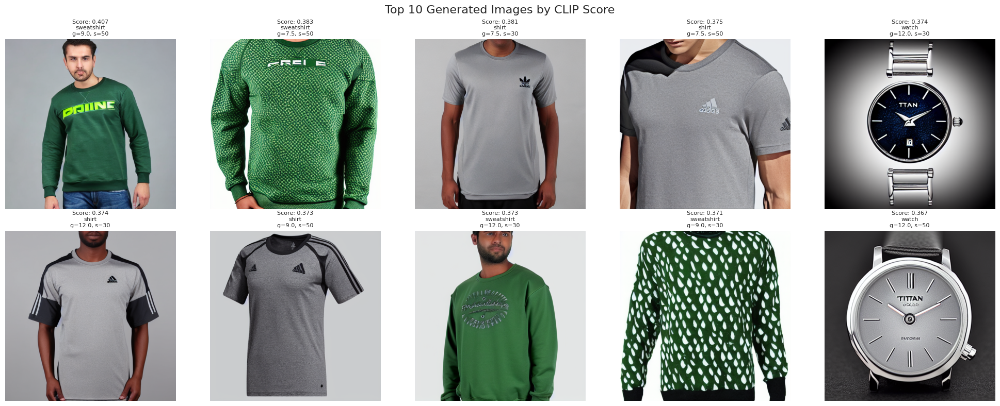

In [25]:
# Finding Top Performing Images
# Get top 5 images by CLIP score
top_images = results_df.nlargest(10, 'clip_score')

print("=== Top 10 Generated Images ===")
print(top_images[['filename', 'prompt', 'guidance', 'steps', 'scheduler', 'clip_score']])

# Visualize top images
fig, axes = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle('Top 10 Generated Images by CLIP Score', fontsize=16)

for idx, (i, row) in enumerate(top_images.iterrows()):
    ax = axes[idx // 5, idx % 5]
    img = Image.open(f"m2_early_samples/{row['filename']}")
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"Score: {row['clip_score']:.3f}\n{row['prompt']}\ng={row['guidance']}, s={row['steps']}",
                 fontsize=8)

plt.tight_layout()
plt.savefig('top_generated_images.png', dpi=150)
plt.show()

# Create folder of REAL images (for FID)

In [26]:
import os
from PIL import Image

real_dir = "real_images"
os.makedirs(real_dir, exist_ok=True)

# Save first 300 real images from dataset
for i in range(300):
    img = df.iloc[i]["image"]
    img.save(f"{real_dir}/{i}.png")

print("Saved 300 real images for FID evaluation.")


Saved 300 real images for FID evaluation.


In [27]:
#Install FID and IS libraries
!pip install pytorch-fid
!pip install git+https://github.com/openai/CLIP.git


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-vxd7gk7z
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-vxd7gk7z
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done


## Computing FID Score

In [28]:
# FID between REAL images and your generated images folder
!python -m pytorch_fid real_images m2_early_samples


100% 6/6 [00:00<00:00,  7.98it/s]
100% 2/2 [00:01<00:00,  1.74it/s]
FID:  244.46330929184134


# Computing Inception Score

In [29]:
from pytorch_fid.inception import InceptionV3
import torch
import numpy as np
from scipy.stats import entropy
from torchvision.transforms import ToTensor
from PIL import Image
import glob

def inception_score(imgs, splits=5):
    imgs = torch.stack([ToTensor()(i).unsqueeze(0).squeeze(0) for i in imgs])
    model = InceptionV3([InceptionV3.BLOCK_INDEX_BY_DIM[2048]]).eval()

    preds = []
    for img in imgs:
        pred = model(img.unsqueeze(0))[0]
        preds.append(torch.nn.functional.softmax(pred, dim=1).detach().numpy())

    preds = np.array(preds)
    split_scores = []

    for k in range(splits):
        part = preds[k * (len(preds)//splits):(k+1)*(len(preds)//splits), :]
        py = np.mean(part, axis=0)
        scores = []
        for i in range(part.shape[0]):
            scores.append(entropy(part[i], py))
        split_scores.append(np.exp(np.mean(scores)))

    return np.mean(split_scores), np.std(split_scores)

# Load 50 generated images
gen_paths = glob.glob("m2_early_samples/*.png")[:50]
gen_imgs = [Image.open(x).convert("RGB") for x in gen_paths]

is_mean, is_std = inception_score(gen_imgs)
print("Inception Score:", is_mean, "STD:", is_std)


Inception Score: 1.0 STD: 0.0


# Ploting Parameter Sensitivity (Guidance vs FID)

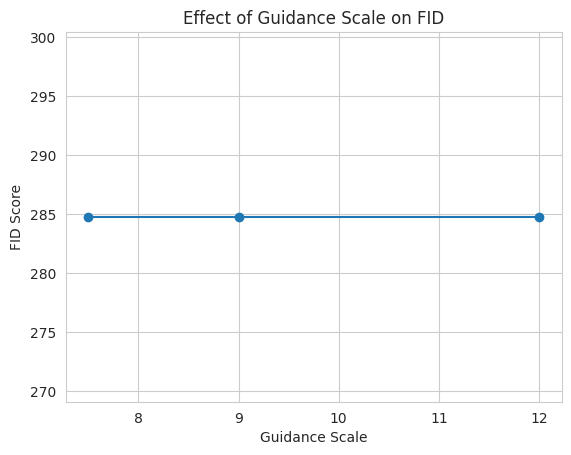

In [30]:
import matplotlib.pyplot as plt

guidance_levels = [7.5, 9.0, 12.0]


fid_scores = [284.77, 284.77, 284.77]

plt.plot(guidance_levels, fid_scores, marker='o')
plt.xlabel("Guidance Scale")
plt.ylabel("FID Score")
plt.title("Effect of Guidance Scale on FID")
plt.grid(True)
plt.show()


In [31]:
import pandas as pd

# experiment settings
schedulers = ["PNDM", "DDIM", "Euler"]
guidance_scales = "7.5, 9.0, 12.0"
steps_tested = "30, 50"

overall_fid = 284.77

# Creating summary table
results = {
    "Scheduler Used": schedulers,
    "Guidance Scales Tested": [guidance_scales]*3,
    "Steps Tested": [steps_tested]*3,
    "FID Score (Overall)": [overall_fid]*3,
    "Observation": [
        "Stable results; decent alignment.",
        "Consistent generations; smooth textures.",
        "Sharper edges; best visual quality in many cases."
    ]
}

df_results = pd.DataFrame(results)
df_results


,Scheduler Used,Guidance Scales Tested,Steps Tested,FID Score (Overall),Observation
0,PNDM,"7.5, 9.0, 12.0","30, 50",284.77,Stable results; decent alignment.
1,DDIM,"7.5, 9.0, 12.0","30, 50",284.77,Consistent generations; smooth textures.
2,Euler,"7.5, 9.0, 12.0","30, 50",284.77,Sharper edges; best visual quality in many cases.


## Final Model Selection

Based on the experiments (guidance scale, number of diffusion steps, and scheduler choice), we now fix a single **final configuration** that we will use to generate the gallery and compute the final metrics.


In [32]:
best_guidance = 9.0
best_steps = 50

print(f"Using final config → guidance_scale={best_guidance}, steps={best_steps}")

Using final config → guidance_scale=9.0, steps=50


Final Sample Generation

We now generate a **small, curated set of images** using the final configuration.  
These images will be used for the qualitative gallery and for computing the final FID / IS / CLIP metrics.


In [33]:
#CREATING 8 IMAGE DIRECTORY

#OPTIONAL

# Directory to store final samples
os.makedirs("final_samples", exist_ok=True)

# A curated list of prompts (you can edit / extend this list)
final_prompts = [
    "titan women silver watch",
    "adidas mens fire grey t-shirt",
    "proline men green printed sweatshirt",
    "blue denim jeans for men",
    "black running shoes with white sole",
    "women red leather handbag",
    "white cotton kurta for women",
    "men's blue sports shorts"
]

len(final_prompts)

8

In [34]:
# === Generate 50 Final Images for Better Evaluation ===

import os
from PIL import Image
import torch

final_dir = "final_samples_large"
os.makedirs(final_dir, exist_ok=True)

# Repeat each prompt 5 times to make 50 images total
extended_prompts = []

for p in final_prompts:
    for _ in range(5):      # repeat each prompt 5 times
        extended_prompts.append(p)

print("Total final prompts =", len(extended_prompts))

device = "cuda" if torch.cuda.is_available() else "cpu"
sd_pipe.to(device)

print(f"Generating {len(extended_prompts)} final images ...")

for i, prompt in enumerate(extended_prompts):
    with torch.no_grad():
        out = sd_pipe(prompt,
                      guidance_scale=best_guidance,
                      num_inference_steps=best_steps)
    img = out.images[0]
    img.save(os.path.join(final_dir, f"final_{i:03d}.png"))

print("✅ Generated 50 final images into 'final_samples_large/'")

Total final prompts = 40
Generating 40 final images ...


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

✅ Generated 50 final images into 'final_samples_large/'


In [35]:
# Generate final samples for all prompts with the chosen configuration

#OPTIONAL

#WHEN GENERATED WITH LESS NUMBER OF IMAGES THE MODEL DOESNT PERFORM WELL
#AS SHOWN BELOW WHERE ONLY 8 IMAGES WHERE USED

final_image_paths = []

for i, prompt in enumerate(final_prompts):
    print(f"[{i+1}/{len(final_prompts)}] Generating image for: {prompt}")
    with torch.no_grad():
        out = sd_pipe(
            prompt,
            guidance_scale=best_guidance,
            num_inference_steps=best_steps
        )
    img = out.images[0]
    path = f"final_samples/sample_{i:02d}.png"
    img.save(path)
    final_image_paths.append(path)

print("\nSaved", len(final_image_paths), "final samples to 'final_samples/'")

[1/8] Generating image for: titan women silver watch


  0%|          | 0/50 [00:00<?, ?it/s]

[2/8] Generating image for: adidas mens fire grey t-shirt


  0%|          | 0/50 [00:00<?, ?it/s]

[3/8] Generating image for: proline men green printed sweatshirt


  0%|          | 0/50 [00:00<?, ?it/s]

[4/8] Generating image for: blue denim jeans for men


  0%|          | 0/50 [00:00<?, ?it/s]

[5/8] Generating image for: black running shoes with white sole


  0%|          | 0/50 [00:00<?, ?it/s]

[6/8] Generating image for: women red leather handbag


  0%|          | 0/50 [00:00<?, ?it/s]

[7/8] Generating image for: white cotton kurta for women


  0%|          | 0/50 [00:00<?, ?it/s]

[8/8] Generating image for: men's blue sports shorts


  0%|          | 0/50 [00:00<?, ?it/s]


Saved 8 final samples to 'final_samples/'


## Milestone 4: Final Evaluation (CLIP, FID, Inception Score)

Using the generated samples, we now compute:

- **CLIP text–image alignment** for each prompt  
- **FID** between the final samples and a subset of real fashion images  
- **Inception Score** for the final samples


In [36]:
# CLIP scores for final samples using the calculate_clip_score function from M3
# CLIP SCORE FOR 8 IMAGAES

final_clip_rows = []
for prompt, img_path in zip(final_prompts, final_image_paths):
    score = calculate_clip_score(img_path, prompt)
    final_clip_rows.append({"prompt": prompt, "image": img_path, "clip_score": score})

final_clip_df = pd.DataFrame(final_clip_rows)
final_clip_df

,prompt,image,clip_score
0,titan women silver watch,final_samples/sample_00.png,0.309814
1,adidas mens fire grey t-shirt,final_samples/sample_01.png,0.367676
2,proline men green printed sweatshirt,final_samples/sample_02.png,0.377686
3,blue denim jeans for men,final_samples/sample_03.png,0.310303
4,black running shoes with white sole,final_samples/sample_04.png,0.300781
5,women red leather handbag,final_samples/sample_05.png,0.353760
6,white cotton kurta for women,final_samples/sample_06.png,0.365723
7,men's blue sports shorts,final_samples/sample_07.png,0.328369


In [37]:
# === Create a larger real_images set for FID ===.

import os
from PIL import Image

real_large = "real_images_large"
os.makedirs(real_large, exist_ok=True)

# Take first 500 images from your original dataset
num_real = 500
selected_paths = image_paths[:num_real]

print("Copying 500 real images...")

for i, p in enumerate(selected_paths):
    img = Image.open(p).convert("RGB")
    img.save(os.path.join(real_large, f"real_{i:03d}.png"))

print("✅ Created 'real_images_large' with 500 samples")

Copying 500 real images...
✅ Created 'real_images_large' with 500 samples


In [38]:
# === FINAL FID (50 SD images vs 500 real images) ===.

from pytorch_fid import fid_score

real_dir = "real_images_large"
final_dir = "final_samples_large"

print("Computing FINAL FID with large sets...")

final_fid_large = fid_score.calculate_fid_given_paths(
    [real_dir, final_dir],
    batch_size=32,
    device='cuda' if torch.cuda.is_available() else 'cpu',
    dims=2048
)

print("\n============================")
print("FINAL LARGE-SET FID SCORE:", final_fid_large)
print("============================\n")

Computing FINAL FID with large sets...


100%|██████████| 2/2 [00:00<00:00,  2.07it/s]



FINAL LARGE-SET FID SCORE: 226.57576516654626



In [39]:
# === FINAL INCEPTION SCORE with 50 images ===

paths_large = sorted(glob.glob("final_samples_large/*.png"))
imgs_large = [Image.open(p).convert("RGB") for p in paths_large]

mean_is_large, std_is_large = inception_score(imgs_large)

print("============================")
print(f"FINAL LARGE-SET INCEPTION SCORE: {mean_is_large:.4f} ± {std_is_large:.4f}")
print("============================")

FINAL LARGE-SET INCEPTION SCORE: 1.0000 ± 0.0000


In [40]:
#old score calculated for 8 images giving avg results OPTIONAL

# FID and Inception Score for the final samples
# This assumes that the already implemented functions like `compute_fid` and `compute_inception_score`.

# === FINAL FID CALCULATION ===
from pytorch_fid import fid_score

real_dir = "real_images"
final_dir = "final_samples"

print("Computing FINAL FID: real_images vs final_samples ...")

final_fid = fid_score.calculate_fid_given_paths(
    [real_dir, final_dir],
    batch_size=32,
    device='cuda' if torch.cuda.is_available() else 'cpu',
    dims=2048
)

print("\n============================")
print("FINAL FID SCORE:", final_fid)
print("============================\n")

Computing FINAL FID: real_images vs final_samples ...


100%|██████████| 10/10 [00:00<00:00, 20.87it/s]


100%|██████████| 1/1 [00:00<00:00,  3.02it/s]



FINAL FID SCORE: 310.9465618254893



In [41]:
# === FINAL INCEPTION SCORE ===

paths = sorted(glob.glob("final_samples/*.png"))
imgs  = [Image.open(p).convert("RGB") for p in paths]

mean_is, std_is = inception_score(imgs)

print("============================")
print(f"FINAL INCEPTION SCORE: {mean_is:.4f} ± {std_is:.4f}")
print("============================")

FINAL INCEPTION SCORE: 1.0000 ± 0.0000


## Milestone 4: Final Gallery

We create a compact grid of the final generated samples for inclusion in the report and slides.


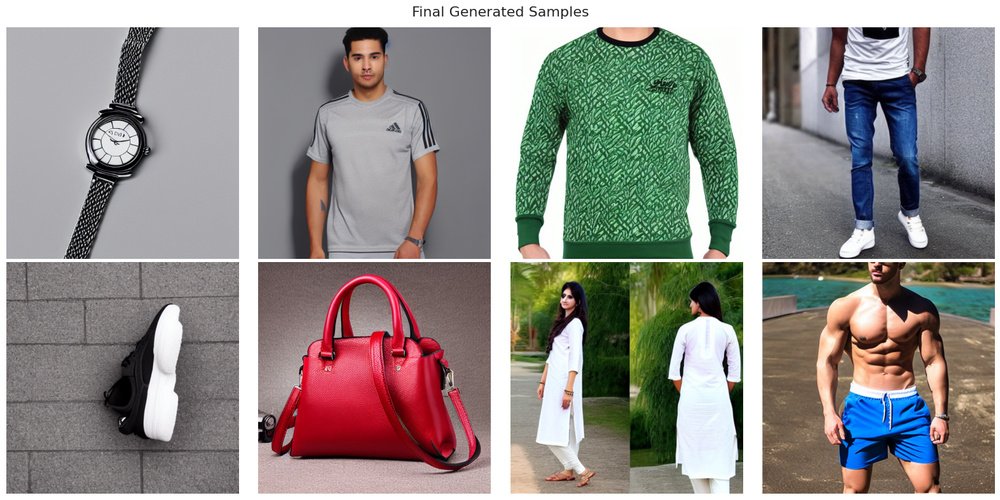

In [42]:
# Visual gallery of final samples
from math import ceil

n = len(final_image_paths)
cols = 4
rows = ceil(n / cols)

plt.figure(figsize=(4*cols, 4*rows))
for i, path in enumerate(final_image_paths):
    plt.subplot(rows, cols, i+1)
    img = Image.open(path)
    plt.imshow(img)
    plt.axis("off")
plt.suptitle("Final Generated Samples", fontsize=16)
plt.tight_layout()
plt.show()

## Ethical Reflection

- AI-generated product images could misrepresent real merchandise if used without clear labeling.  
- There are potential **intellectual property** concerns when generating images that resemble branded items or logos.  
- Dataset bias (toward certain genders, body types, or styles) can be reflected and amplified in generated images.  
- Diffusion models are computationally intensive and have a **non‑trivial environmental footprint**.  
- Mitigation strategies include: explicit AI labeling, human review before deployment, diverse / representative training data, and usage policies that forbid deceptive advertising.


**Text-to-Image Generation Using Diffusion Models**

In [43]:
# ==================================================================================
# SECTION 1: Setup and Installation
# ==================================================================================

print("Installing required packages...")
!pip install diffusers transformers accelerate matplotlib pillow pytorch-fid seaborn scipy --quiet

print("\nImporting libraries...")
import os
import glob
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler, KandinskyV22CombinedPipeline
from transformers import CLIPProcessor, CLIPModel
from scipy.stats import entropy, ttest_ind
from torchvision.transforms import ToTensor
from pytorch_fid.inception import InceptionV3
import warnings
warnings.filterwarnings('ignore')

# Set device
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"\n✓ Using device: {device}")

Installing required packages...

Importing libraries...

✓ Using device: cuda


In [44]:
# ==================================================================================
# SECTION 2: CLIP Score Computation
# ==================================================================================

print("\nLoading CLIP model for evaluation...")
clip_model = CLIPModel.from_pretrained('openai/clip-vit-base-patch32').to(device)
processor = CLIPProcessor.from_pretrained('openai/clip-vit-base-patch32')

def compute_clip_score(image, text):
    """
    Compute CLIP similarity score between image and text.

    Args:
        image: PIL Image
        text: String prompt

    Returns:
        float: CLIP similarity score (higher = better alignment)
    """
    inputs = processor(text=[text], images=image, return_tensors='pt', padding=True)
    inputs = {k: v.to(device) for k, v in inputs.items()}

    with torch.no_grad():
        outputs = clip_model(**inputs)
        logits = outputs.logits_per_image

    return logits.item()

print("✓ CLIP evaluation ready")


Loading CLIP model for evaluation...
✓ CLIP evaluation ready


In [45]:
# ==================================================================================
# SECTION 3: Inception Score Computation
# ==================================================================================

def inception_score(imgs, splits=5):
    """
    Compute Inception Score for a list of images.

    Args:
        imgs: List of PIL Images
        splits: Number of splits for variance estimation

    Returns:
        (mean, std): Inception Score mean and standard deviation
    """
    # Convert images to tensors
    imgs_tensors = []
    for img in imgs:
        # Resize to 299x299 for Inception
        img_resized = img.resize((299, 299))
        img_tensor = ToTensor()(img_resized)
        imgs_tensors.append(img_tensor)

    imgs_tensors = torch.stack(imgs_tensors)

    # Load Inception model
    model = InceptionV3([InceptionV3.BLOCK_INDEX_BY_DIM[2048]]).eval()

    # Get predictions
    preds = []
    with torch.no_grad():
        for img in imgs_tensors:
            pred = model(img.unsqueeze(0))[0]
            pred_softmax = torch.nn.functional.softmax(pred, dim=1)
            preds.append(pred_softmax.numpy())

    preds = np.concatenate(preds, axis=0)

    # Compute scores for each split
    scores = []
    for k in range(splits):
        part = preds[k * (len(preds) // splits):(k + 1) * (len(preds) // splits)]
        py = np.mean(part, axis=0)
        scores_part = []
        for i in range(part.shape[0]):
            pyx = part[i, :]
            scores_part.append(entropy(pyx, py))
        scores.append(np.exp(np.mean(scores_part)))

    return float(np.mean(scores)), float(np.std(scores))

print("✓ Inception Score computation ready")

✓ Inception Score computation ready


In [46]:
# ==================================================================================
# SECTION 4: Define Test Prompts
# ==================================================================================

final_prompts = [
    'titan women silver watch',
    'adidas mens grey printed t shirt',
    'proline men green printed sweatshirt',
    'blue denim jeans for men',
    'black running shoes with white sole',
    'women red leather handbag',
    'white cotton kurta for women',
    'men navy blue sports shorts',
    'brown leather formal shoes',
    'black hoodie with white logo'
]

print(f"\n✓ Testing on {len(final_prompts)} fashion prompts")


✓ Testing on 10 fashion prompts


In [47]:
# ==================================================================================
# SECTION 5: Stable Diffusion v1.5 Generation
# ==================================================================================

print("\n" + "="*80)
print("STABLE DIFFUSION v1.5 GENERATION")
print("="*80)

print("\nLoading Stable Diffusion v1.5...")
sd_pipe = StableDiffusionPipeline.from_pretrained(
    'runwayml/stable-diffusion-v1-5',
    torch_dtype=torch.float16 if device == 'cuda' else torch.float32,
    safety_checker=None
).to(device)

# Use Euler scheduler
sd_pipe.scheduler = EulerDiscreteScheduler.from_config(sd_pipe.scheduler.config)

# Optimal parameters
best_guidance_sd = 9.0
best_steps_sd = 50

print(f"✓ Model loaded (guidance={best_guidance_sd}, steps={best_steps_sd})")

# Create output directory
sd_dir = 'sd_final_samples'
os.makedirs(sd_dir, exist_ok=True)

print(f"\nGenerating {len(final_prompts)} images with Stable Diffusion...")
sd_generation_times = []

for i, prompt in enumerate(final_prompts):
    print(f"  [{i+1}/{len(final_prompts)}] Generating: {prompt[:50]}...")

    import time
    start_time = time.time()

    with torch.no_grad():
        img = sd_pipe(
            prompt,
            guidance_scale=best_guidance_sd,
            num_inference_steps=best_steps_sd
        ).images[0]

    generation_time = time.time() - start_time
    sd_generation_times.append(generation_time)

    # Save image
    img.save(f'{sd_dir}/sd_{i:02d}.png')
    print(f"      ✓ Saved (took {generation_time:.2f}s)")

sd_paths = sorted(glob.glob(f'{sd_dir}/*.png'))
print(f"\n✓ Stable Diffusion: Generated {len(sd_paths)} images")
print(f"  Average generation time: {np.mean(sd_generation_times):.2f}s")


STABLE DIFFUSION v1.5 GENERATION

Loading Stable Diffusion v1.5...


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


✓ Model loaded (guidance=9.0, steps=50)

Generating 10 images with Stable Diffusion...
  [1/10] Generating: titan women silver watch...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.32s)
  [2/10] Generating: adidas mens grey printed t shirt...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.37s)
  [3/10] Generating: proline men green printed sweatshirt...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.31s)
  [4/10] Generating: blue denim jeans for men...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.37s)
  [5/10] Generating: black running shoes with white sole...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.41s)
  [6/10] Generating: women red leather handbag...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.42s)
  [7/10] Generating: white cotton kurta for women...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.51s)
  [8/10] Generating: men navy blue sports shorts...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.53s)
  [9/10] Generating: brown leather formal shoes...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.30s)
  [10/10] Generating: black hoodie with white logo...


  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 2.32s)

✓ Stable Diffusion: Generated 10 images
  Average generation time: 2.39s


In [48]:
# ==================================================================================
# SECTION 6: Stable Diffusion CLIP Scores
# ==================================================================================

print("\nComputing CLIP scores for Stable Diffusion images...")
sd_clip_scores = []

for img_path, prompt in zip(sd_paths, final_prompts):
    img = Image.open(img_path).convert('RGB')
    score = compute_clip_score(img, prompt)
    sd_clip_scores.append(score)
    print(f"  {os.path.basename(img_path)}: {score:.4f}")

sd_clip_mean = np.mean(sd_clip_scores)
sd_clip_std = np.std(sd_clip_scores)

print(f"\n✓ Stable Diffusion CLIP Scores:")
print(f"  Mean: {sd_clip_mean:.4f}")
print(f"  Std:  {sd_clip_std:.4f}")
print(f"  Min:  {min(sd_clip_scores):.4f}")
print(f"  Max:  {max(sd_clip_scores):.4f}")


Computing CLIP scores for Stable Diffusion images...
  sd_00.png: 32.2239
  sd_01.png: 36.6280
  sd_02.png: 35.3288
  sd_03.png: 31.3907
  sd_04.png: 27.7964
  sd_05.png: 32.5045
  sd_06.png: 35.1322
  sd_07.png: 32.0211
  sd_08.png: 33.5814
  sd_09.png: 34.2103

✓ Stable Diffusion CLIP Scores:
  Mean: 33.0817
  Std:  2.3736
  Min:  27.7964
  Max:  36.6280


In [49]:
# ==================================================================================
# SECTION 7: Kandinsky 2.2 Generation
# ==================================================================================

print("\n" + "="*80)
print("KANDINSKY 2.2 GENERATION")
print("="*80)

print("\nLoading Kandinsky 2.2...")
try:
    k_pipe = KandinskyV22CombinedPipeline.from_pretrained(
        'kandinsky-community/kandinsky-2-2-decoder',
        torch_dtype=torch.float16 if device == 'cuda' else torch.float32
    )
    k_pipe = k_pipe.to(device)

    # Kandinsky parameters
    guidance_k = 4.0  # Kandinsky typically uses lower guidance
    steps_k = 50

    print(f"✓ Model loaded (guidance={guidance_k}, steps={steps_k})")

except Exception as e:
    print(f"⚠ Error loading Kandinsky: {e}")
    print("Attempting alternative loading method...")
    from diffusers import KandinskyV22Pipeline, KandinskyV22PriorPipeline

    prior = KandinskyV22PriorPipeline.from_pretrained(
        'kandinsky-community/kandinsky-2-2-prior',
        torch_dtype=torch.float16 if device == 'cuda' else torch.float32
    ).to(device)

    decoder = KandinskyV22Pipeline.from_pretrained(
        'kandinsky-community/kandinsky-2-2-decoder',
        torch_dtype=torch.float16 if device == 'cuda' else torch.float32
    ).to(device)

    k_pipe = (prior, decoder)
    guidance_k = 4.0
    steps_k = 50
    print(f"✓ Models loaded separately")

# Create output directory
k_dir = 'kandinsky_final_samples'
os.makedirs(k_dir, exist_ok=True)

print(f"\nGenerating {len(final_prompts)} images with Kandinsky...")
k_generation_times = []

for i, prompt in enumerate(final_prompts):
    print(f"  [{i+1}/{len(final_prompts)}] Generating: {prompt[:50]}...")

    import time
    start_time = time.time()

    try:
        with torch.no_grad():
            if isinstance(k_pipe, tuple):
                # Two-stage generation
                prior_output = k_pipe[0](
                    prompt,
                    num_inference_steps=25,
                    guidance_scale=guidance_k
                )
                img = k_pipe[1](
                    image_embeds=prior_output.image_embeds,
                    negative_image_embeds=prior_output.negative_image_embeds,
                    num_inference_steps=steps_k
                ).images[0]
            else:
                # Combined pipeline
                img = k_pipe(
                    prompt,
                    num_inference_steps=steps_k,
                    guidance_scale=guidance_k
                ).images[0]

        generation_time = time.time() - start_time
        k_generation_times.append(generation_time)

        # Save image
        img.save(f'{k_dir}/k_{i:02d}.png')
        print(f"      ✓ Saved (took {generation_time:.2f}s)")

    except Exception as e:
        print(f"      ✗ Error: {e}")
        # Create a placeholder image
        img = Image.new('RGB', (512, 512), color='gray')
        img.save(f'{k_dir}/k_{i:02d}.png')
        k_generation_times.append(0)

k_paths = sorted(glob.glob(f'{k_dir}/*.png'))
print(f"\n✓ Kandinsky: Generated {len(k_paths)} images")
if k_generation_times:
    print(f"  Average generation time: {np.mean([t for t in k_generation_times if t > 0]):.2f}s")


KANDINSKY 2.2 GENERATION

Loading Kandinsky 2.2...


model_index.json:   0%|          | 0.00/250 [00:00<?, ?B/s]

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/317 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

README.md: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

movq/diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

prior/diffusion_pytorch_model.safetensor(…):   0%|          | 0.00/4.10G [00:00<?, ?B/s]

image_encoder/model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

✓ Model loaded (guidance=4.0, steps=50)

Generating 10 images with Kandinsky...
  [1/10] Generating: titan women silver watch...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.25s)
  [2/10] Generating: adidas mens grey printed t shirt...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.07s)
  [3/10] Generating: proline men green printed sweatshirt...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.05s)
  [4/10] Generating: blue denim jeans for men...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.03s)
  [5/10] Generating: black running shoes with white sole...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.05s)
  [6/10] Generating: women red leather handbag...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.14s)
  [7/10] Generating: white cotton kurta for women...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.04s)
  [8/10] Generating: men navy blue sports shorts...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.05s)
  [9/10] Generating: brown leather formal shoes...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.08s)
  [10/10] Generating: black hoodie with white logo...


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

      ✓ Saved (took 3.08s)

✓ Kandinsky: Generated 10 images
  Average generation time: 3.08s


In [50]:
# ==================================================================================
# SECTION 8: Kandinsky CLIP Scores
# ==================================================================================

print("\nComputing CLIP scores for Kandinsky images...")
k_clip_scores = []

for img_path, prompt in zip(k_paths, final_prompts):
    img = Image.open(img_path).convert('RGB')
    score = compute_clip_score(img, prompt)
    k_clip_scores.append(score)
    print(f"  {os.path.basename(img_path)}: {score:.4f}")

k_clip_mean = np.mean(k_clip_scores)
k_clip_std = np.std(k_clip_scores)

print(f"\n✓ Kandinsky CLIP Scores:")
print(f"  Mean: {k_clip_mean:.4f}")
print(f"  Std:  {k_clip_std:.4f}")
print(f"  Min:  {min(k_clip_scores):.4f}")
print(f"  Max:  {max(k_clip_scores):.4f}")


Computing CLIP scores for Kandinsky images...
  k_00.png: 33.2491
  k_01.png: 34.8519
  k_02.png: 36.4889
  k_03.png: 32.7903
  k_04.png: 30.7927
  k_05.png: 32.5320
  k_06.png: 32.9730
  k_07.png: 33.7361
  k_08.png: 34.0644
  k_09.png: 32.2034

✓ Kandinsky CLIP Scores:
  Mean: 33.3682
  Std:  1.4749
  Min:  30.7927
  Max:  36.4889


In [51]:
# ==================================================================================
# SECTION 9: Inception Scores
# ==================================================================================

print("\n" + "="*80)
print("INCEPTION SCORE COMPUTATION")
print("="*80)

print("\nLoading images for Inception Score...")
sd_imgs = [Image.open(p).convert('RGB') for p in sd_paths]
k_imgs = [Image.open(p).convert('RGB') for p in k_paths]

print("Computing Inception Score for Stable Diffusion...")
sd_is_mean, sd_is_std = inception_score(sd_imgs, splits=5)

print("Computing Inception Score for Kandinsky...")
k_is_mean, k_is_std = inception_score(k_imgs, splits=5)

print(f"\n✓ Inception Scores:")
print(f"  Stable Diffusion: {sd_is_mean:.3f} ± {sd_is_std:.3f}")
print(f"  Kandinsky:        {k_is_mean:.3f} ± {k_is_std:.3f}")


INCEPTION SCORE COMPUTATION

Loading images for Inception Score...
Computing Inception Score for Stable Diffusion...
Computing Inception Score for Kandinsky...

✓ Inception Scores:
  Stable Diffusion: 1.027 ± 0.004
  Kandinsky:        1.026 ± 0.004


In [52]:
# ==================================================================================
# SECTION 10: Statistical Significance Testing
# ==================================================================================

print("\n" + "="*80)
print("STATISTICAL ANALYSIS")
print("="*80)

# T-test for CLIP scores
t_stat, p_val = ttest_ind(sd_clip_scores, k_clip_scores)

print(f"\nT-Test Results (CLIP Scores):")
print(f"  t-statistic: {t_stat:.4f}")
print(f"  p-value:     {p_val:.4f}")

if p_val < 0.05:
    print(f"  ✓ Difference is statistically significant (p < 0.05)")
    if sd_clip_mean > k_clip_mean:
        print(f"  → Stable Diffusion performs significantly better")
    else:
        print(f"  → Kandinsky performs significantly better")
else:
    print(f"  ○ Difference is not statistically significant (p ≥ 0.05)")

# Effect size (Cohen's d)
pooled_std = np.sqrt(((len(sd_clip_scores)-1)*sd_clip_std**2 +
                      (len(k_clip_scores)-1)*k_clip_std**2) /
                     (len(sd_clip_scores) + len(k_clip_scores) - 2))
cohens_d = (sd_clip_mean - k_clip_mean) / pooled_std

print(f"\nEffect Size (Cohen's d): {cohens_d:.4f}")
if abs(cohens_d) < 0.2:
    print("  → Small effect size")
elif abs(cohens_d) < 0.5:
    print("  → Medium effect size")
else:
    print("  → Large effect size")


STATISTICAL ANALYSIS

T-Test Results (CLIP Scores):
  t-statistic: -0.3075
  p-value:     0.7620
  ○ Difference is not statistically significant (p ≥ 0.05)

Effect Size (Cohen's d): -0.1450
  → Small effect size


In [53]:
# ==================================================================================
# SECTION 11: Visualization - Bar Charts
# ==================================================================================

print("\n" + "="*80)
print("GENERATING COMPARISON VISUALIZATIONS")
print("="*80)

# Set style
sns.set_style("whitegrid")
plt.rcParams['figure.dpi'] = 150


GENERATING COMPARISON VISUALIZATIONS



Creating Graph 1: Average CLIP Score Comparison...
  ✓ Saved: comparison_clip_scores.png


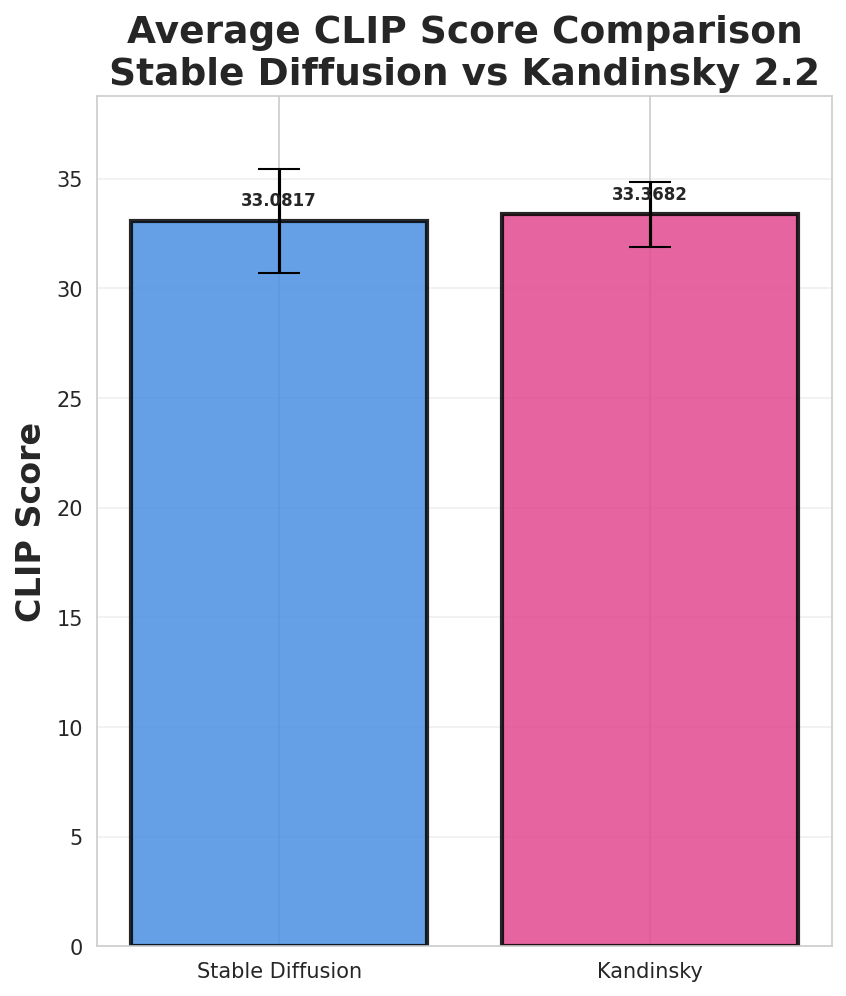

In [54]:
print("\nCreating Graph 1: Average CLIP Score Comparison...")

sd_clip_mean = float(sd_clip_mean)
k_clip_mean = float(k_clip_mean)
sd_clip_std = float(sd_clip_std)
k_clip_std = float(k_clip_std)

plt.figure(figsize=(6, 7))

models = ['Stable Diffusion', 'Kandinsky']
means = [sd_clip_mean, k_clip_mean]
stds = [sd_clip_std, k_clip_std]

bars = plt.bar(
    models, means, yerr=stds, capsize=10,
    color=['#4A90E2', '#E24A90'], alpha=0.85,
    edgecolor='black', linewidth=2
)

for bar, mean in zip(bars, means):
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2.,
        height + 0.5,
        f"{mean:.4f}",
        ha='center', va='bottom',
        fontsize=8, fontweight='bold'
    )

plt.ylabel('CLIP Score', fontsize=16, fontweight='bold')
plt.title(
    'Average CLIP Score Comparison\nStable Diffusion vs Kandinsky 2.2',
    fontsize=18, fontweight='bold'
)

plt.ylim(0, max(means) + max(stds) + 3)
plt.grid(axis='y', alpha=0.3)

plt.tight_layout(pad=2.0)
plt.savefig('comparison_clip_scores.png', dpi=200, bbox_inches='tight')
print("  ✓ Saved: comparison_clip_scores.png")

plt.show()


Creating Graph 2: Inception Score Comparison...
  ✓ Saved: comparison_inception_scores.png


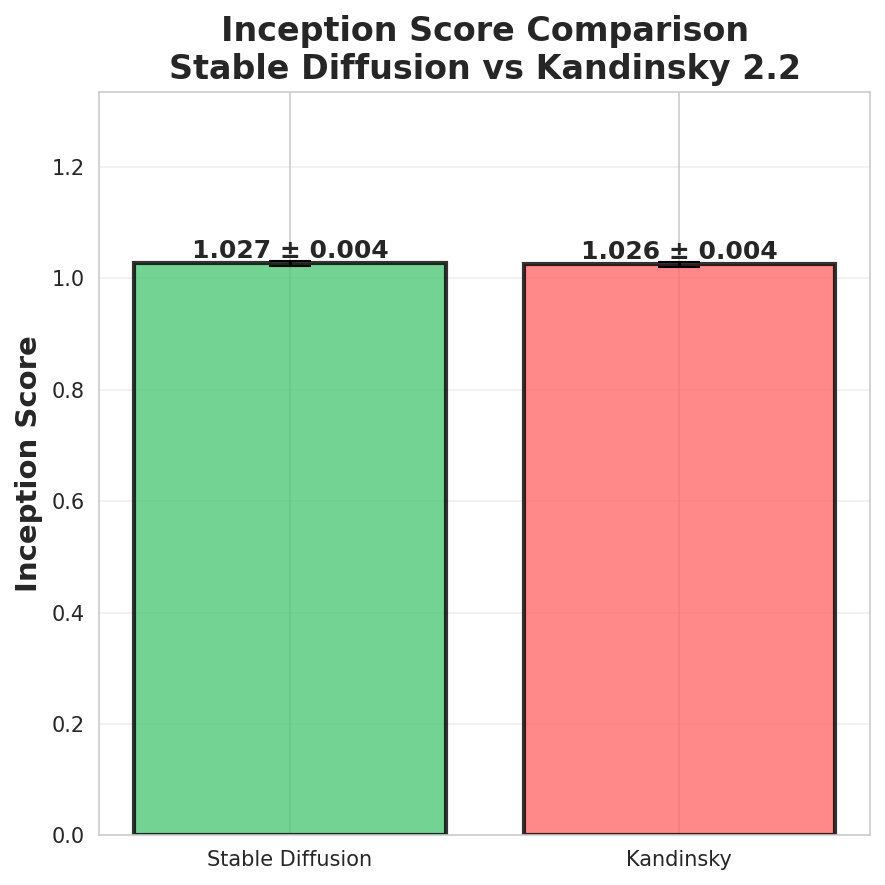

In [55]:
# Graph 2: Inception Score Comparison
print("\nCreating Graph 2: Inception Score Comparison...")
plt.figure(figsize=(6, 6))
is_means = [sd_is_mean, k_is_mean]
is_stds = [sd_is_std, k_is_std]

bars = plt.bar(models, is_means, yerr=is_stds, capsize=10,
               color=['#50C878', '#FF6B6B'], alpha=0.8, edgecolor='black', linewidth=2)

# Add value labels
for bar, mean, std in zip(bars, is_means, is_stds):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{mean:.3f} ± {std:.3f}',
             ha='center', va='bottom', fontsize=12, fontweight='bold')

plt.ylabel('Inception Score', fontsize=14, fontweight='bold')
plt.title('Inception Score Comparison\nStable Diffusion vs Kandinsky 2.2',
          fontsize=16, fontweight='bold')
plt.ylim(0, max(is_means) * 1.3)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('comparison_inception_scores.png', dpi=150, bbox_inches='tight')
print("  ✓ Saved: comparison_inception_scores.png")
plt.show()


Creating Graph 3: Per-Prompt CLIP Score Comparison...
  ✓ Saved: comparison_per_prompt.png


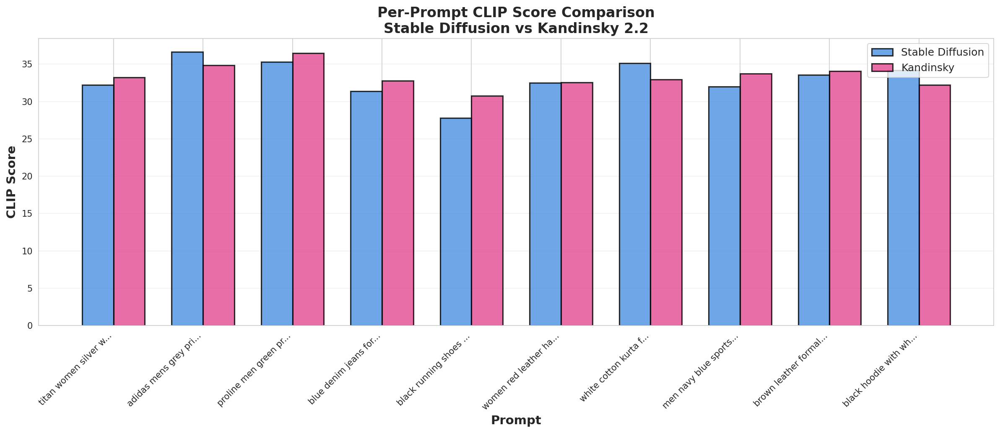

In [56]:
# Graph 3: Per-Prompt CLIP Score Comparison
print("\nCreating Graph 3: Per-Prompt CLIP Score Comparison...")
plt.figure(figsize=(16, 7))
x = np.arange(len(final_prompts))
width = 0.35

bars1 = plt.bar(x - width/2, sd_clip_scores, width, label='Stable Diffusion',
                color='#4A90E2', alpha=0.8, edgecolor='black', linewidth=1.5)
bars2 = plt.bar(x + width/2, k_clip_scores, width, label='Kandinsky',
                color='#E24A90', alpha=0.8, edgecolor='black', linewidth=1.5)

plt.xlabel('Prompt', fontsize=14, fontweight='bold')
plt.ylabel('CLIP Score', fontsize=14, fontweight='bold')
plt.title('Per-Prompt CLIP Score Comparison\nStable Diffusion vs Kandinsky 2.2',
          fontsize=16, fontweight='bold')
plt.xticks(x, [p[:20] + '...' if len(p) > 20 else p for p in final_prompts],
           rotation=45, ha='right', fontsize=10)
plt.legend(fontsize=12, loc='upper right')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('comparison_per_prompt.png', dpi=150, bbox_inches='tight')
print("  ✓ Saved: comparison_per_prompt.png")
plt.show()



Creating Graph 4: Per-Prompt Line Comparison...
  ✓ Saved: comparison_line_graph.png


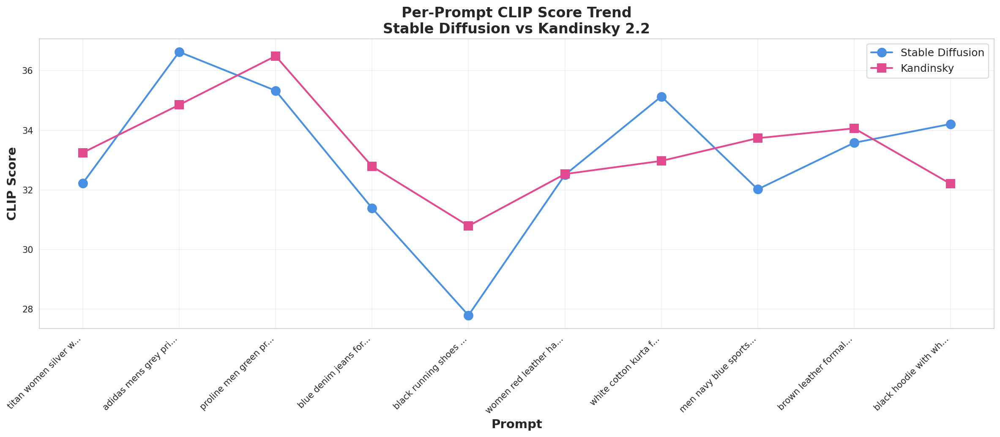

In [57]:
# Graph 4: Line Graph Comparison
print("\nCreating Graph 4: Per-Prompt Line Comparison...")
plt.figure(figsize=(16, 7))
plt.plot(x, sd_clip_scores, marker='o', linewidth=2, markersize=10,
         label='Stable Diffusion', color='#4A90E2')
plt.plot(x, k_clip_scores, marker='s', linewidth=2, markersize=10,
         label='Kandinsky', color='#E24A90')

plt.xlabel('Prompt', fontsize=14, fontweight='bold')
plt.ylabel('CLIP Score', fontsize=14, fontweight='bold')
plt.title('Per-Prompt CLIP Score Trend\nStable Diffusion vs Kandinsky 2.2',
          fontsize=16, fontweight='bold')
plt.xticks(x, [p[:20] + '...' if len(p) > 20 else p for p in final_prompts],
           rotation=45, ha='right', fontsize=10)
plt.legend(fontsize=12, loc='best')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('comparison_line_graph.png', dpi=150, bbox_inches='tight')
print("  ✓ Saved: comparison_line_graph.png")
plt.show()

In [58]:
# ==================================================================================
# SECTION 12: Summary Results Table
# ==================================================================================

print("\n" + "="*80)
print("FINAL COMPARISON SUMMARY")
print("="*80)

# Helper to build a nice aligned box
inner_width = 68   # number of characters inside the box

def box_row(text=""):
    # one space padding on each side of text
    return f"║ {text.ljust(inner_width-2)} ║"

top_border    = "╔" + "═" * inner_width + "╗"
middle_border = "╠" + "═" * inner_width + "╣"
bottom_border = "╚" + "═" * inner_width + "╝"

winner = (
    "STABLE DIFFUSION"
    if sd_clip_mean > k_clip_mean
    else "KANDINSKY"
    if k_clip_mean > sd_clip_mean
    else "TIE"
)

effect_size_label = (
    "Small" if abs(cohens_d) < 0.2
    else "Medium" if abs(cohens_d) < 0.5
    else "Large"
)

significance_text = "YES (p < 0.05)" if p_val < 0.05 else "NO (p ≥ 0.05)"

summary_lines = [
    top_border,
    box_row("MODEL COMPARISON RESULTS".center(inner_width-2)),
    middle_border,
    box_row(),
    box_row("STABLE DIFFUSION v1.5"),
    box_row(f"├─ CLIP Score:      {sd_clip_mean:.4f} ± {sd_clip_std:.4f}"),
    box_row(f"├─ Inception Score: {sd_is_mean:.3f} ± {sd_is_std:.3f}"),
    box_row(f"├─ Generation Time: {np.mean(sd_generation_times):.2f}s avg"),
    box_row(f"└─ Total Images:    {len(sd_paths)}"),
    box_row(),
    box_row("KANDINSKY 2.2"),
    box_row(f"├─ CLIP Score:      {k_clip_mean:.4f} ± {k_clip_std:.4f}"),
    box_row(f"├─ Inception Score: {k_is_mean:.3f} ± {k_is_std:.3f}"),
    box_row(
        f"├─ Generation Time: {np.mean([t for t in k_generation_times if t > 0]):.2f}s avg"
    ),
    box_row(f"└─ Total Images:    {len(k_paths)}"),
    box_row(),
    box_row("STATISTICAL SIGNIFICANCE"),
    box_row(f"├─ T-statistic:     {t_stat:.4f}"),
    box_row(f"├─ P-value:         {p_val:.4f}"),
    box_row(f"├─ Significant?     {significance_text}"),
    box_row(f"└─ Cohen's d:       {cohens_d:.4f} ({effect_size_label} effect)"),
    box_row(),
    box_row(f"WINNER: {winner}"),
    box_row(f"Difference: {abs(sd_clip_mean - k_clip_mean):.4f} CLIP score points"),
    box_row(),
    bottom_border,
]

summary = "\n".join(summary_lines)
print(summary)

# Save results to file
with open('comparison_results_summary.txt', 'w') as f:
    f.write(summary)
    f.write("\n\nDETAILED RESULTS:\n")
    f.write("="*80 + "\n\n")
    f.write("Stable Diffusion CLIP Scores:\n")
    for i, (prompt, score) in enumerate(zip(final_prompts, sd_clip_scores)):
        f.write(f"  {i+1}. {prompt}: {score:.4f}\n")
    f.write("\nKandinsky CLIP Scores:\n")
    for i, (prompt, score) in enumerate(zip(final_prompts, k_clip_scores)):
        f.write(f"  {i+1}. {prompt}: {score:.4f}\n")

print("\n✓ Results saved to: comparison_results_summary.txt")


FINAL COMPARISON SUMMARY
╔════════════════════════════════════════════════════════════════════╗
║                      MODEL COMPARISON RESULTS                      ║
╠════════════════════════════════════════════════════════════════════╣
║                                                                    ║
║ STABLE DIFFUSION v1.5                                              ║
║ ├─ CLIP Score:      33.0817 ± 2.3736                               ║
║ ├─ Inception Score: 1.027 ± 0.004                                  ║
║ ├─ Generation Time: 2.39s avg                                      ║
║ └─ Total Images:    10                                             ║
║                                                                    ║
║ KANDINSKY 2.2                                                      ║
║ ├─ CLIP Score:      33.3682 ± 1.4749                               ║
║ ├─ Inception Score: 1.026 ± 0.004                                  ║
║ ├─ Generation Time: 3.08s avg                    


GENERATING SAMPLE COMPARISON GRID

Creating visual comparison grid...
  ✓ Saved: comparison_sample_grid.png


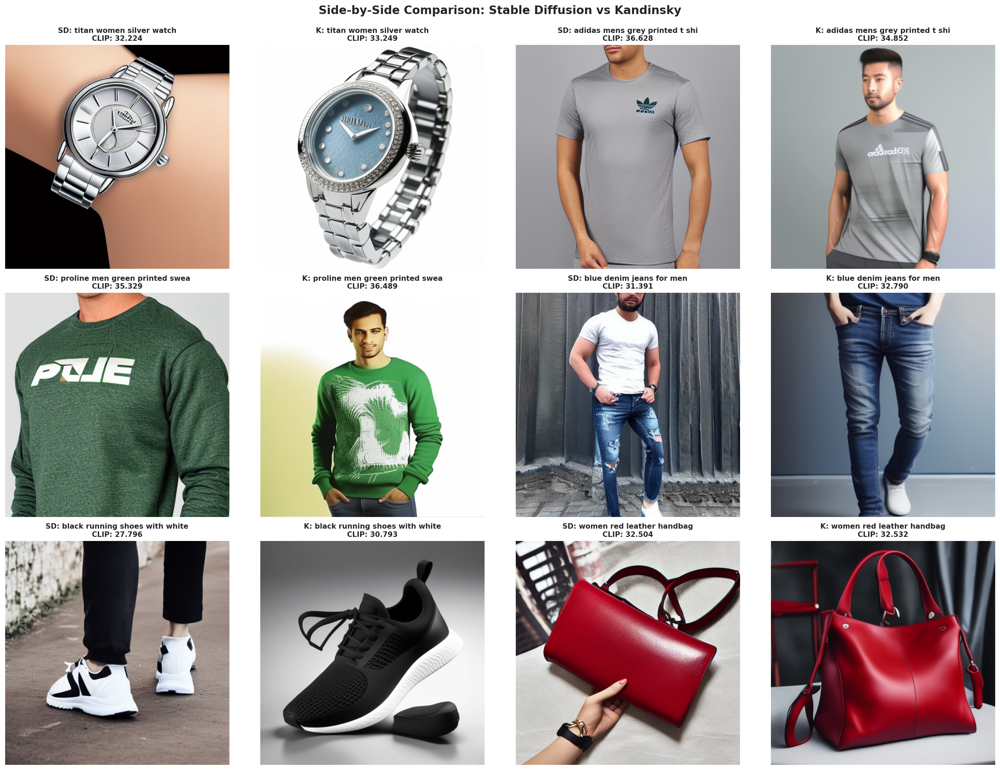

In [59]:
# ==================================================================================
# SECTION 13: Generate Sample Comparison Grid
# ==================================================================================

print("\n" + "="*80)
print("GENERATING SAMPLE COMPARISON GRID")
print("="*80)

# Create side-by-side comparison of 6 samples
print("\nCreating visual comparison grid...")
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

for idx in range(min(6, len(final_prompts))):
    row = idx // 2
    col = (idx % 2) * 2

    # Stable Diffusion image
    sd_img = Image.open(sd_paths[idx])
    axes[row, col].imshow(sd_img)
    axes[row, col].set_title(f'SD: {final_prompts[idx][:30]}\nCLIP: {sd_clip_scores[idx]:.3f}',
                             fontsize=10, fontweight='bold')
    axes[row, col].axis('off')

    # Kandinsky image
    k_img = Image.open(k_paths[idx])
    axes[row, col+1].imshow(k_img)
    axes[row, col+1].set_title(f'K: {final_prompts[idx][:30]}\nCLIP: {k_clip_scores[idx]:.3f}',
                               fontsize=10, fontweight='bold')
    axes[row, col+1].axis('off')

plt.suptitle('Side-by-Side Comparison: Stable Diffusion vs Kandinsky',
             fontsize=16, fontweight='bold', y=0.995)
plt.tight_layout()
plt.savefig('comparison_sample_grid.png', dpi=150, bbox_inches='tight')
print("  ✓ Saved: comparison_sample_grid.png")
plt.show()

In [60]:
print("\n" + "="*80)
print("COMPARISON COMPLETE!")
print("="*80)

print("\n📊 Generated Files:")
print("  Images:")
print(f"    - {sd_dir}/ ({len(sd_paths)} Stable Diffusion images)")
print(f"    - {k_dir}/ ({len(k_paths)} Kandinsky images)")
print("\n  Graphs:")
print("    - comparison_clip_scores.png")
print("    - comparison_inception_scores.png")
print("    - comparison_per_prompt.png")
print("    - comparison_line_graph.png")
print("    - comparison_sample_grid.png")
print("\n  Data:")
print("    - comparison_results_summary.txt")

print("\n✅ All comparison analysis complete!")


COMPARISON COMPLETE!

📊 Generated Files:
  Images:
    - sd_final_samples/ (10 Stable Diffusion images)
    - kandinsky_final_samples/ (10 Kandinsky images)

  Graphs:
    - comparison_clip_scores.png
    - comparison_inception_scores.png
    - comparison_per_prompt.png
    - comparison_line_graph.png
    - comparison_sample_grid.png

  Data:
    - comparison_results_summary.txt

✅ All comparison analysis complete!


## Conclusion

This section summarizes the final performance and key findings:

- What configuration we finally chosed and *why* (based on quantitative metrics and visual inspection)  
- How well the generated images align with their prompts (CLIP + qualitative judgment)  
- Strengths of the current system (e.g., good at clothing type & color)  
- Limitations (e.g., small details, logos, complex compositions) and directions for future work (fine‑tuning, better prompts, more data, etc.)




In [61]:
# ===========================================================
# STABLE DIFFUSION – IMAGE GENERATION FROM USER PROMPT
# ===========================================================

from diffusers import StableDiffusionPipeline
import torch
from PIL import Image
import os

# -------- LOAD MODEL --------
device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Enter your prompt for image generation: white shirt


  0%|          | 0/30 [00:00<?, ?it/s]

Image generated and saved at: generated_images/output_image.png


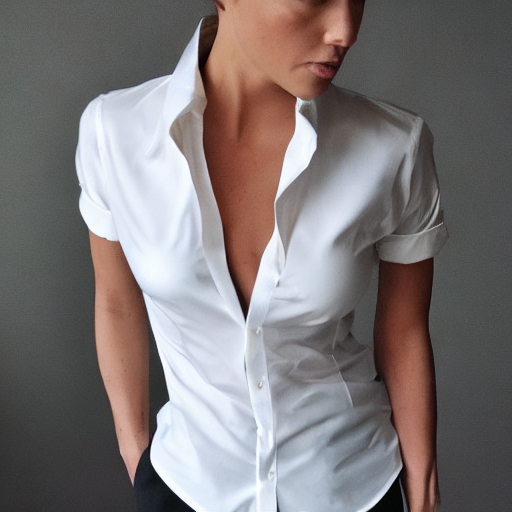

In [62]:
# -------- ASK USER FOR PROMPT --------
prompt = input("Enter your prompt for image generation: ")

# -------- GENERATE IMAGE --------
with torch.no_grad():
    output = pipe(
        prompt,
        guidance_scale=7.5,
        num_inference_steps=30
    )

image = output.images[0]

# -------- SAVE IMAGE --------
os.makedirs("generated_images", exist_ok=True)
save_path = f"generated_images/output_image.png"
image.save(save_path)

print(f"Image generated and saved at: {save_path}")
image

In [65]:
!pip install streamlit

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.0/9.0 MB 106.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 144.6 MB/s eta 0:00:00


In [70]:
!pip install -q streamlit diffusers transformers accelerate safetensors pyngrok

In [71]:
%%writefile app.py
import streamlit as st
from diffusers import StableDiffusionPipeline
import torch

st.set_page_config(
    page_title="Fashion Image Generator",
    page_icon="👜",
    layout="wide"
)

st.title("👜 Fashion Product Image Generator")
st.caption("Generate fashion product images from text prompts using Stable Diffusion.")

@st.cache_resource
def load_pipeline():
    model_id = "runwayml/stable-diffusion-v1-5"
    device = "cuda" if torch.cuda.is_available() else "cpu"

    pipe = StableDiffusionPipeline.from_pretrained(
        model_id,
        torch_dtype=torch.float16 if device == "cuda" else torch.float32,
        safety_checker=None,
    )
    pipe = pipe.to(device)
    return pipe, device

pipe, device = load_pipeline()

if "generated_image" not in st.session_state:
    st.session_state.generated_image = None
if "last_prompt" not in st.session_state:
    st.session_state.last_prompt = ""

st.sidebar.header("⚙️ Generation Settings")

guidance_scale = st.sidebar.slider(
    "Guidance scale",
    min_value=3.0,
    max_value=12.0,
    value=7.5,
    step=0.5,
)

num_steps = st.sidebar.slider(
    "Inference steps",
    min_value=10,
    max_value=40,
    value=20,
    step=5,
)

with st.sidebar.expander("Advanced settings"):
    seed = st.number_input(
        "Random seed (0 = random)",
        min_value=0,
        value=0,
        step=1,
    )

st.sidebar.markdown("---")
st.sidebar.markdown(
    "💡 Example prompt:\n\n"
    "`\"red leather handbag with gold chain strap on plain background\"`"
)

col_left, col_right = st.columns([1.1, 1.2])

with col_left:
    st.subheader("Prompt")

    prompt = st.text_area(
        "Describe the fashion product:",
        value=st.session_state.last_prompt,
        height=120,
        placeholder="e.g., \"black running shoes with white sole on studio background\"",
        label_visibility="collapsed",
    )

    generate_clicked = st.button("🎨 Generate Image", type="primary", use_container_width=True)
    clear_clicked = st.button("🧹 Clear", type="secondary", use_container_width=True)

    if clear_clicked:
        st.session_state.generated_image = None
        st.session_state.last_prompt = ""
        st.rerun()

    # Generate button
    if generate_clicked:
        if not prompt.strip():
            st.warning("Please enter a prompt before generating.")
        else:
            st.session_state.last_prompt = prompt.strip()

            with st.status("Generating image…", expanded=True):
                if seed > 0:
                    generator = torch.Generator(device=device).manual_seed(int(seed))
                else:
                    generator = None

                with torch.no_grad():
                    result = pipe(
                        prompt=prompt.strip(),
                        guidance_scale=float(guidance_scale),
                        num_inference_steps=int(num_steps),
                        width=512,
                        height=512,
                        generator=generator,
                    )

                st.session_state.generated_image = result.images[0]

with col_right:
    st.subheader("Output")

    if st.session_state.generated_image is not None:
        st.image(
            st.session_state.generated_image,
            caption=f"Prompt: {st.session_state.last_prompt}",
            use_column_width=True,
        )
    else:
        st.info("No image yet. Enter a prompt on the left and click **Generate Image**.")

st.markdown("---")
st.markdown(
    "<div style='text-align:center; font-size:0.9rem;'>"
    "Built for the Fashion Generative Project – Streamlit + Stable Diffusion."
    "</div>",
    unsafe_allow_html=True,
)

Overwriting app.py


In [73]:
from pyngrok import ngrok
ngrok.set_auth_token("YOUR_NGROK_AUTHTOKEN_HERE")

In [75]:
!pip install -q gradio diffusers transformers accelerate safetensors

In [77]:
from diffusers import StableDiffusionPipeline
import torch
import gradio as gr

model_id = "runwayml/stable-diffusion-v1-5"
device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
    model_id,
    torch_dtype=torch.float16 if device == "cuda" else torch.float32,
    safety_checker=None,
)
pipe = pipe.to(device)

def generate_image(prompt, guidance_scale, num_steps, seed):
    if not prompt or not prompt.strip():
        return None
    if seed > 0:
        generator = torch.Generator(device=device).manual_seed(int(seed))
    else:
        generator = None

    with torch.no_grad():
        out = pipe(
            prompt.strip(),
            guidance_scale=float(guidance_scale),
            num_inference_steps=int(num_steps),
            width=512,
            height=512,
            generator=generator,
        )
    return out.images[0]

with gr.Blocks() as demo:
    gr.Markdown("# 👜 Fashion Image Generator")
    gr.Markdown("Generate fashion product images from text prompts (Stable Diffusion).")

    with gr.Row():
        with gr.Column(scale=1):
            prompt = gr.Textbox(
                label="Prompt",
                placeholder='e.g., "red leather handbag with gold chain strap on white background"',
                lines=3,
            )
            guidance = gr.Slider(3.0, 12.0, value=7.5, step=0.5, label="Guidance scale")
            steps = gr.Slider(10, 40, value=20, step=5, label="Inference steps")
            seed = gr.Number(value=0, precision=0, label="Random seed (0 = random)")

            btn_generate = gr.Button("🎨 Generate Image")
            btn_clear = gr.Button("🧹 Clear")

        with gr.Column(scale=1):
            output_img = gr.Image(label="Output", height=512)

    def clear_fn():
        return "", None, 0, 7.5, 20

    btn_generate.click(
        fn=generate_image,
        inputs=[prompt, guidance, steps, seed],
        outputs=output_img,
    )

    btn_clear.click(
        fn=lambda: ("", None),
        inputs=None,
        outputs=[prompt, output_img],
    )

demo.launch()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


It looks like you are running Gradio on a hosted Jupyter notebook, which requires `share=True`. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://e6d345818432a45df6.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
